In this notebook I will design and train a GAN to generate fake images from CIFAR-10 dataset

In [1]:
# Import necessary packages
import tensorflow as tf 
from tensorflow import keras
import matplotlib.pyplot as plt
import numpy as np
import time
import pandas as pd
import seaborn as sns

In [2]:
# For the reproducibility of the results
np.random.seed(42)
tf.random.set_seed(42)

In [3]:
# Load the CIFAR-10 data directly from keras
from keras.datasets.cifar10 import load_data
(X_train_full, y_train_full), (X_test, y_test) = load_data()
# Print the shape of the datasets
print('Train:' , X_train_full.shape, y_train_full.shape)
print('Test:' , X_test.shape, y_test.shape)

Using TensorFlow backend.
Train: (50000, 32, 32, 3) (50000, 1)
Test: (10000, 32, 32, 3) (10000, 1)


In [4]:
# Scale images from [0,255] to [0,1]
X_train_full = X_train_full.astype(np.float32) / 255
X_test = X_test.astype(np.float32) / 255
# Define the validation dataset
X_train, X_valid = X_train_full[:-5000], X_train_full[-5000:]
y_train, y_valid = y_train_full[:-5000], y_train_full[-5000:]

In [5]:
# Function to plot multiple images
def plot_multiple_images(images, n_cols, n_rows):
    if images.shape[-1] == 1:
        images = np.squeeze(images, axis=-1)
    plt.figure(figsize=(n_cols, n_rows))
    for index in range(n_cols * n_rows):
        plt.subplot(n_rows, n_cols, index + 1)
        plt.imshow(images[index])
        plt.axis("off")

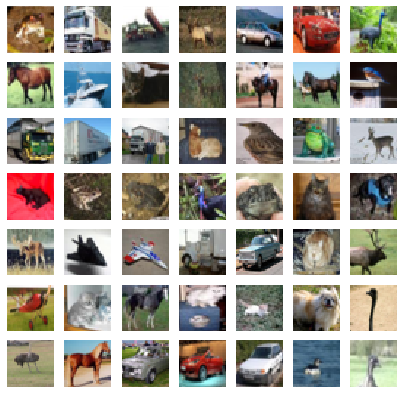

In [6]:
# Show the first 49 images in the train dataset
plot_multiple_images(X_train, 7, 7)

In [7]:
# Rescale the images to [-1,1]
X_train = X_train.reshape(-1, 32, 32, 3) * 2. - 1.
X_valid = X_valid.reshape(-1, 32, 32, 3) * 2. - 1.
# Defining the latent representation
codings_size=100
# Generator model
generator= keras.models.Sequential([
    keras.layers.Dense(8 * 8 * 256, input_shape=[codings_size]),
    keras.layers.Reshape([8, 8, 256]),
    keras.layers.BatchNormalization(),
    keras.layers.Conv2DTranspose(64, kernel_size=5, strides=2, padding='same', activation='selu'),
    keras.layers.BatchNormalization(),
    keras.layers.Conv2DTranspose(3, kernel_size=5, strides=2, padding='same', activation='tanh')
])
# Discriminator model
discriminator = keras.models.Sequential([
    keras.layers.Conv2D(64, kernel_size=5, strides=2, padding='same', activation=keras.layers.LeakyReLU(0.2), input_shape=[32, 32, 3]),
    keras.layers.Dropout(0.4),
    keras.layers.Conv2D(128, kernel_size=5, strides=2, padding='same', activation=keras.layers.LeakyReLU(0.2)),
    keras.layers.Dropout(0.4),
    keras.layers.Conv2D(128, kernel_size=5, strides=2, padding='same', activation=keras.layers.LeakyReLU(0.2)),
    keras.layers.Dropout(0.4),
    keras.layers.Conv2D(256, kernel_size=5, strides=2, padding='same', activation=keras.layers.LeakyReLU(0.2)),
    keras.layers.Dropout(0.4),
    keras.layers.Flatten(),
    keras.layers.Dense(1, activation='sigmoid')
])
gan = keras.models.Sequential([generator, discriminator])
# Compile discriminator
discriminator.compile(loss="binary_crossentropy", optimizer="rmsprop")
# Do not train the discriminator
discriminator.trainable = False
# Compile the gan model
gan.compile(loss="binary_crossentropy", optimizer="rmsprop")

In [8]:
# Summary of the generator
generator.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 16384)             1654784   
_________________________________________________________________
reshape (Reshape)            (None, 8, 8, 256)         0         
_________________________________________________________________
batch_normalization (BatchNo (None, 8, 8, 256)         1024      
_________________________________________________________________
conv2d_transpose (Conv2DTran (None, 16, 16, 64)        409664    
_________________________________________________________________
batch_normalization_1 (Batch (None, 16, 16, 64)        256       
_________________________________________________________________
conv2d_transpose_1 (Conv2DTr (None, 32, 32, 3)         4803      
Total params: 2,070,531
Trainable params: 2,069,891
Non-trainable params: 640
____________________________________________

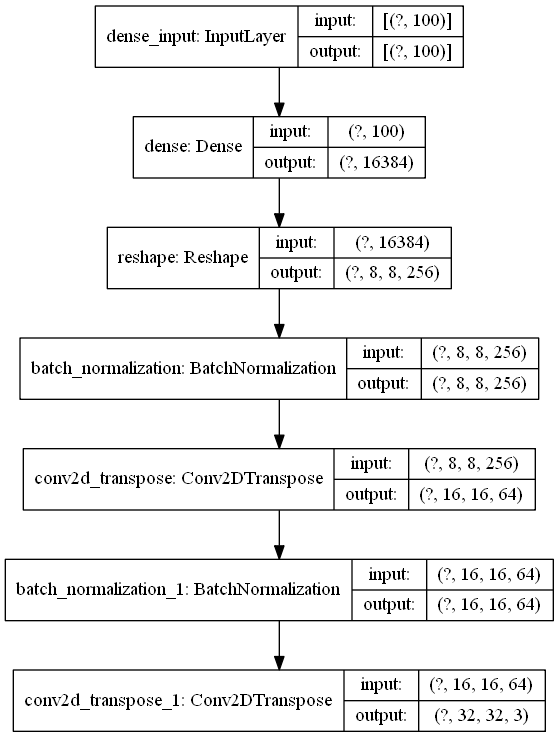

In [9]:
# Graph of the generator
tf.keras.utils.plot_model(generator, show_layer_names=True, show_shapes=True)

In [10]:
# Summary of the discriminator
discriminator.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 16, 16, 64)        4864      
_________________________________________________________________
dropout (Dropout)            (None, 16, 16, 64)        0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 8, 8, 128)         204928    
_________________________________________________________________
dropout_1 (Dropout)          (None, 8, 8, 128)         0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 4, 4, 128)         409728    
_________________________________________________________________
dropout_2 (Dropout)          (None, 4, 4, 128)         0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 2, 2, 256)        

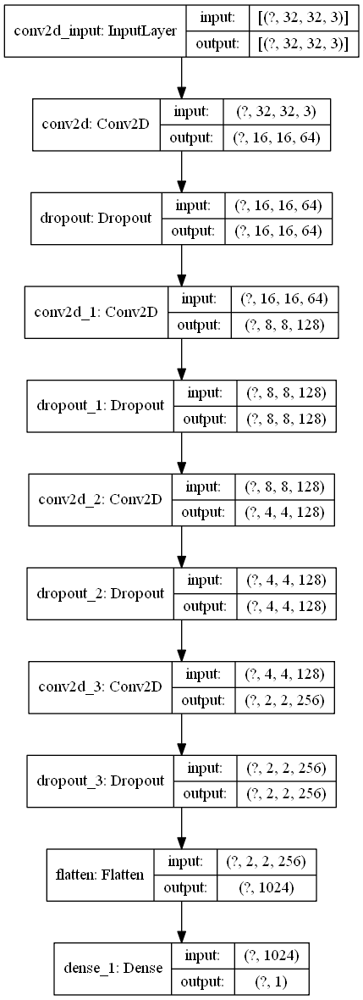

In [11]:
# Graph of the discriminator
tf.keras.utils.plot_model(discriminator, show_layer_names=True, show_shapes=True)

In [12]:
# Summary of the whole GAN model
gan.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
sequential (Sequential)      (None, 32, 32, 3)         2070531   
_________________________________________________________________
sequential_1 (Sequential)    (None, 1)                 1440001   
Total params: 3,510,532
Trainable params: 2,069,891
Non-trainable params: 1,440,641
_________________________________________________________________


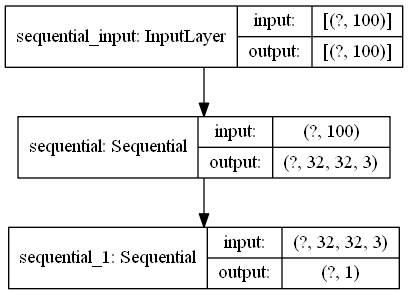

In [13]:
# Graph of the whole model
tf.keras.utils.plot_model(gan, show_layer_names=True, show_shapes=True)

In [14]:
# Create a dataset to iterate through images
batch_size = 32
dataset = tf.data.Dataset.from_tensor_slices(X_train).shuffle(1000)
dataset = dataset.batch(batch_size, drop_remainder=True).prefetch(1)

In [15]:
# Create a validation dataset
valid_dataset = tf.data.Dataset.from_tensor_slices(X_valid).shuffle(1000)
valid_dataset = valid_dataset.batch(batch_size, drop_remainder=True).prefetch(1)

We will compute the discriminator accuracy every 10 epochs using this function:

In [16]:
def discriminator_accuracy(model, dataset):
    generator, discriminator = model.layers
    batch_size = 32
    codings_size = 100
    accuracy = []
    for X_batch in dataset:
        noise = tf.random.normal(shape=[batch_size, codings_size])
        # Produce fake images from noise
        generated_images = generator(noise)
        # Concatenate fake and real images
        X_fake_and_real = tf.concat([generated_images, X_batch], axis=0)
        # Set target=0 for fake images and target=1 for real images
        y1 = tf.constant([[0.]] * batch_size + [[1.]] * batch_size)
        # Get the accuracy of the discriminator on the batch of images
        batch_accuracy = discriminator.evaluate(X_fake_and_real, y1, verbose=0)
        accuracy.append(batch_accuracy)
    return np.mean(accuracy)

This is the function for training the GAN:

In [17]:
# Function for the training loop
def train_gan(gan, dataset, batch_size, codings_size, n_epochs):
    accuracy = pd.DataFrame(columns=['Epoch', 'Accuracy'])
    generator, discriminator = gan.layers
    i=0
    for epoch in range(n_epochs):
        print("Epoch {}/{}".format(epoch + 1, n_epochs))
        # Set an initial time
        start_time = time.time()
        for X_batch in dataset:
            # Training the discriminator
            noise = tf.random.normal(shape=[batch_size, codings_size])
            # Produce fake images from noise
            generated_images = generator(noise)
            # Concatenate fake and real images
            X_fake_and_real = tf.concat([generated_images, X_batch], axis=0)
            # Set target=0 for fake images and target=1 for real images
            y1 = tf.constant([[0.]] * batch_size + [[1.]] * batch_size)
            # Train the discriminator on the batch
            discriminator.trainable = True
            discriminator.train_on_batch(X_fake_and_real, y1)

            # Training the generator
            noise = tf.random.normal(shape=[batch_size, codings_size])
            # Set all fake images generated as real
            y2 = tf.constant([[1.]] * batch_size)
            # Do not train the discriminator
            discriminator.trainable = False
            # Train the generator with the noise
            gan.train_on_batch(noise, y2)
        if (epoch+1) % 10 == 0:
            epoch_accuracy = discriminator_accuracy(gan, valid_dataset)
            accuracy.loc[i,'Epoch'] = epoch
            accuracy.loc[i, 'Accuracy'] = epoch_accuracy
            i+=1
        # Rescale generated images from [-1,1] to [0,1]
        generated_images = (generated_images + 1) / 2.0
        # Plot the generated images
        plot_multiple_images(generated_images, 8, int(batch_size/8))
        print('Execution time:', time.time() - start_time)
        plt.show()
    return accuracy

Now we can train the GAN for 100 epochs:

Epoch 1/100
Execution time: 60.48318552970886


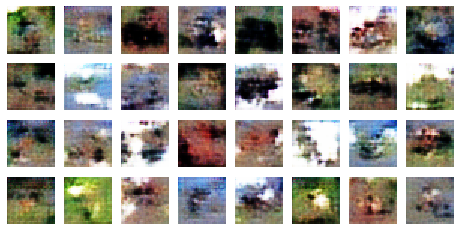

Epoch 2/100
Execution time: 56.31810140609741


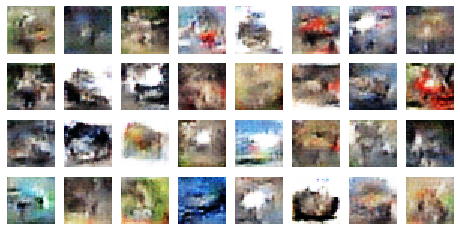

Epoch 3/100
Execution time: 56.68977332115173


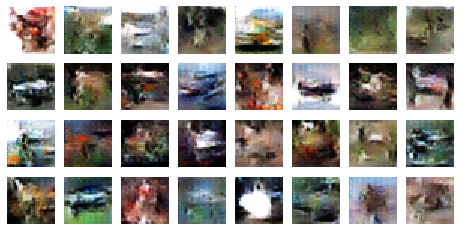

Epoch 4/100
Execution time: 56.804389238357544


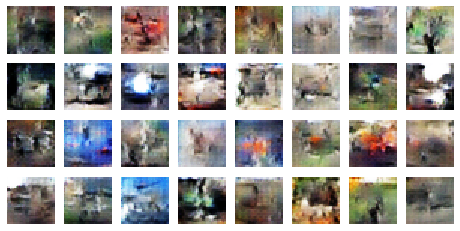

Epoch 5/100
Execution time: 57.18636870384216


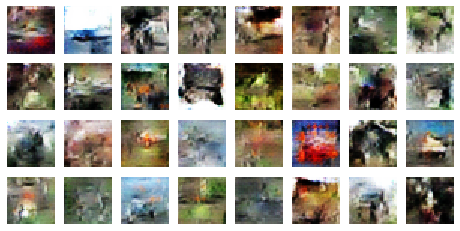

Epoch 6/100
Execution time: 58.88982701301575


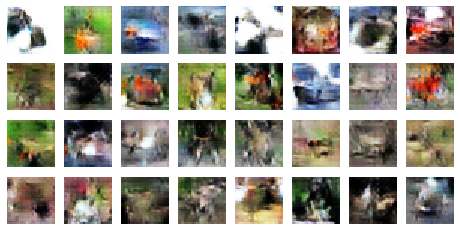

Epoch 7/100
Execution time: 56.7486138343811


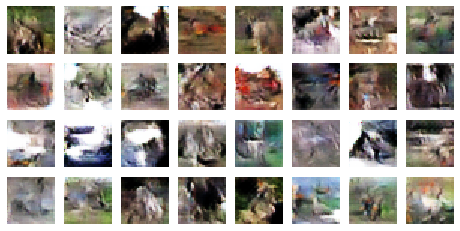

Epoch 8/100
Execution time: 56.656901836395264


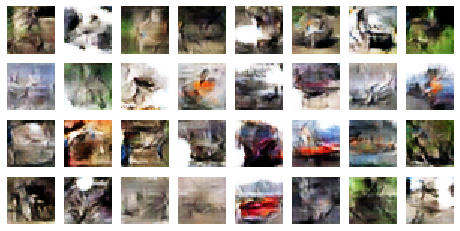

Epoch 9/100
Execution time: 56.53575158119202


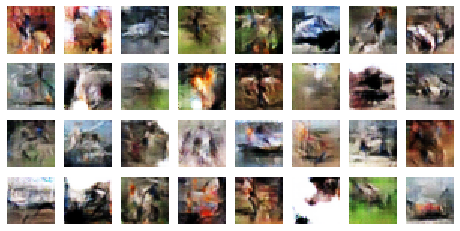

Epoch 10/100
Execution time: 63.469969272613525


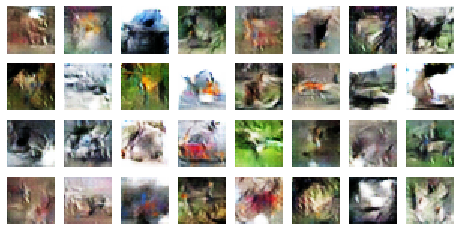

Epoch 11/100
Execution time: 56.76578140258789


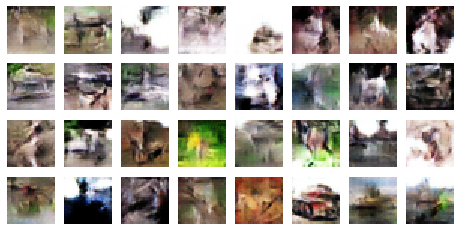

Epoch 12/100
Execution time: 56.65984082221985


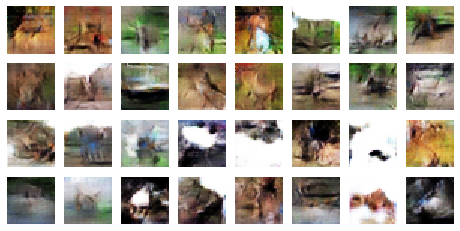

Epoch 13/100
Execution time: 56.734543561935425


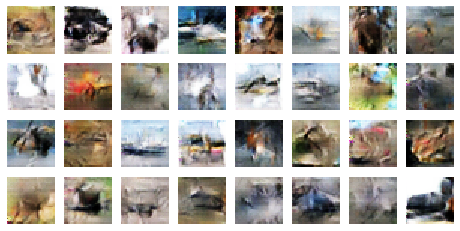

Epoch 14/100
Execution time: 56.24160718917847


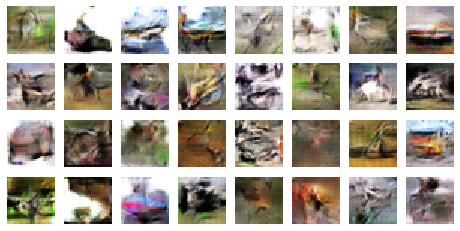

Epoch 15/100
Execution time: 56.391740798950195


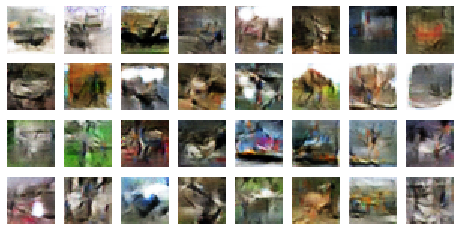

Epoch 16/100
Execution time: 56.74115252494812


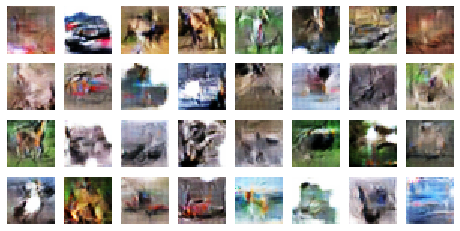

Epoch 17/100
Execution time: 56.535956144332886


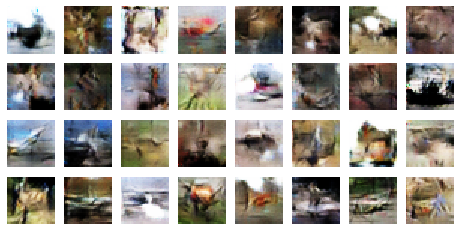

Epoch 18/100
Execution time: 56.67265820503235


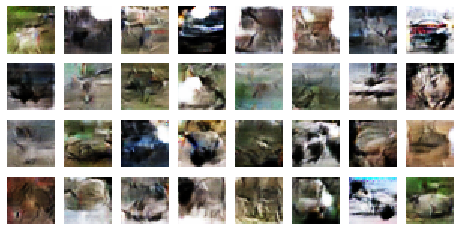

Epoch 19/100
Execution time: 56.626489877700806


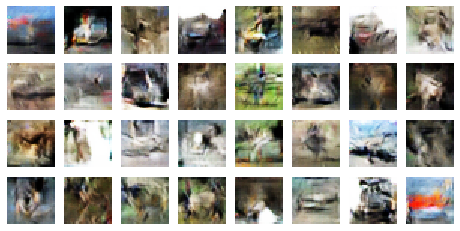

Epoch 20/100
Execution time: 63.62637186050415


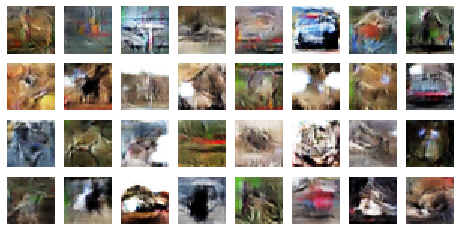

Epoch 21/100
Execution time: 56.91309309005737


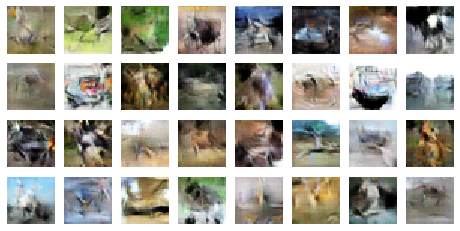

Epoch 22/100
Execution time: 56.70847821235657


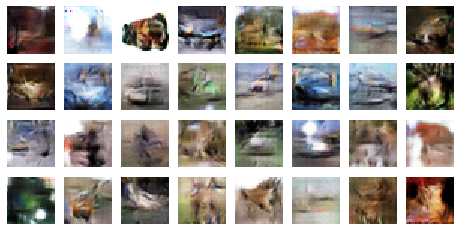

Epoch 23/100
Execution time: 56.8561155796051


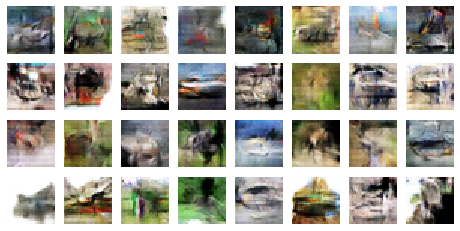

Epoch 24/100
Execution time: 56.69427013397217


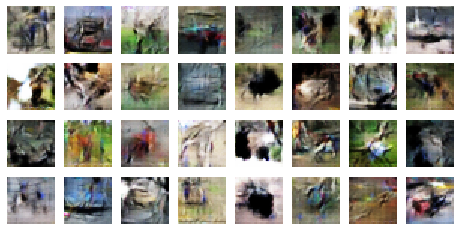

Epoch 25/100
Execution time: 56.45718264579773


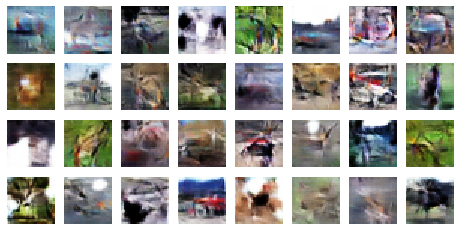

Epoch 26/100
Execution time: 56.682196855545044


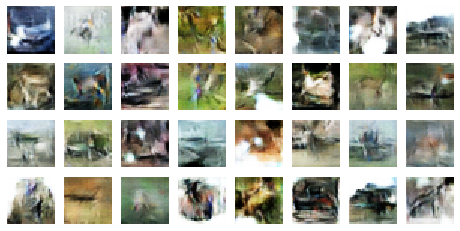

Epoch 27/100
Execution time: 56.34414458274841


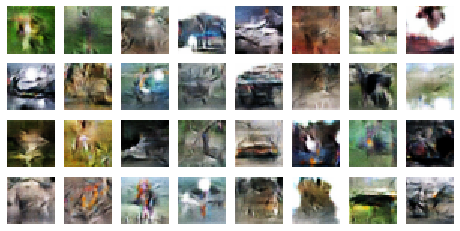

Epoch 28/100
Execution time: 56.558037996292114


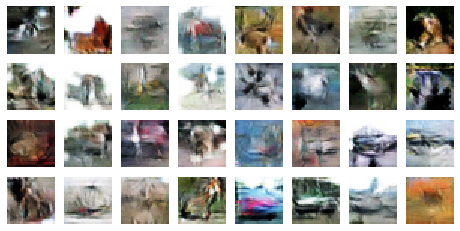

Epoch 29/100
Execution time: 56.66027808189392


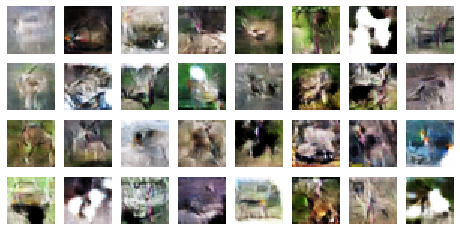

Epoch 30/100
Execution time: 63.689704179763794


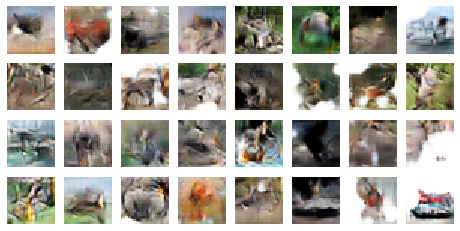

Epoch 31/100
Execution time: 56.98856830596924


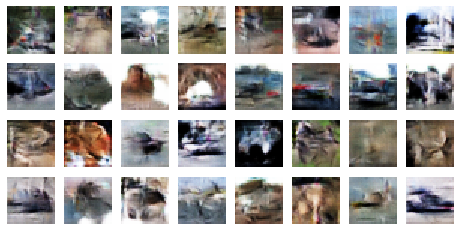

Epoch 32/100
Execution time: 56.65798568725586


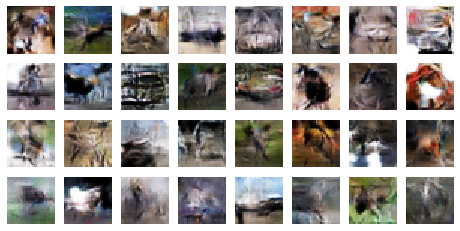

Epoch 33/100
Execution time: 56.9478702545166


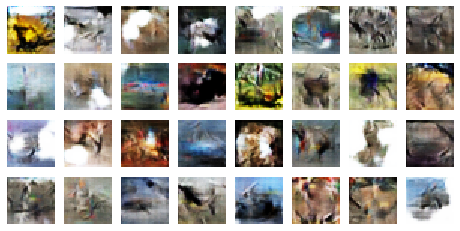

Epoch 34/100
Execution time: 56.549838066101074


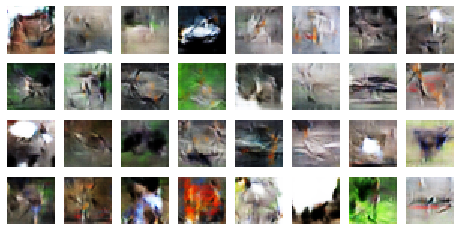

Epoch 35/100
Execution time: 56.71901774406433


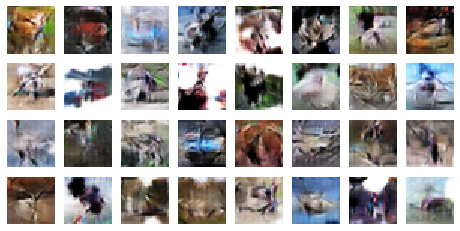

Epoch 36/100
Execution time: 56.70539569854736


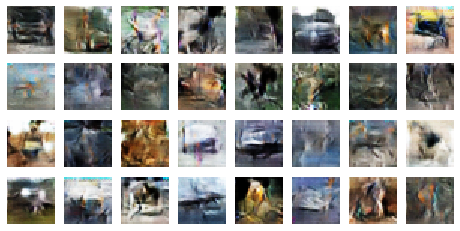

Epoch 37/100
Execution time: 56.29374814033508


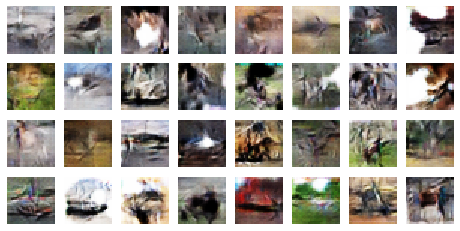

Epoch 38/100
Execution time: 56.533215045928955


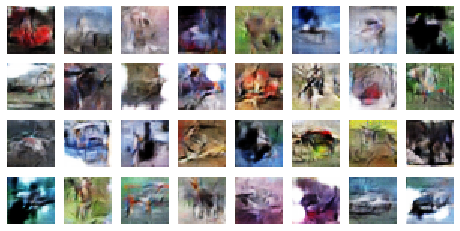

Epoch 39/100
Execution time: 56.85921907424927


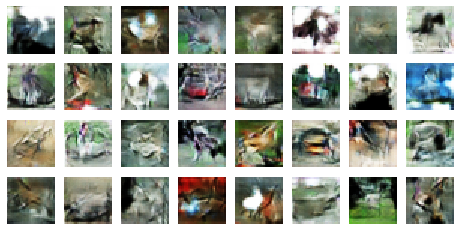

Epoch 40/100
Execution time: 63.54858136177063


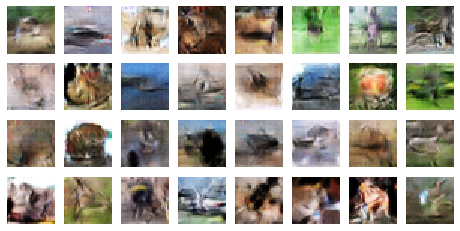

Epoch 41/100
Execution time: 57.04125452041626


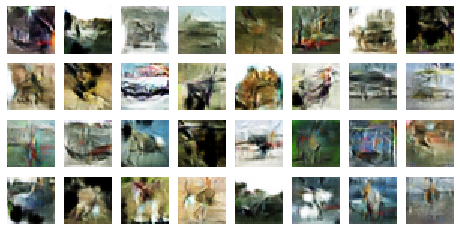

Epoch 42/100
Execution time: 56.904215812683105


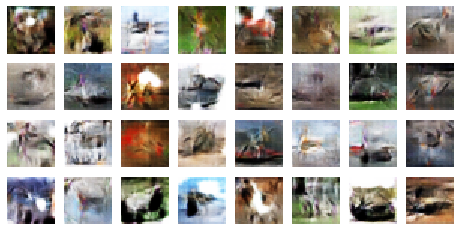

Epoch 43/100
Execution time: 56.82998847961426


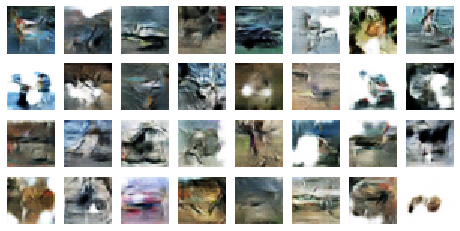

Epoch 44/100
Execution time: 56.36523675918579


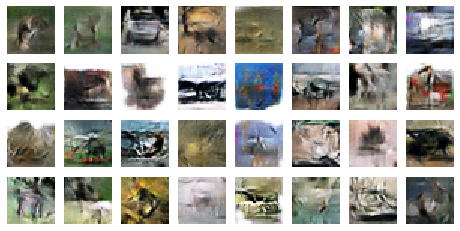

Epoch 45/100
Execution time: 56.67382287979126


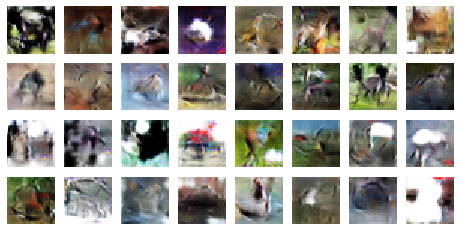

Epoch 46/100
Execution time: 56.683717250823975


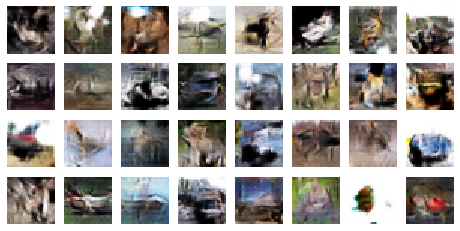

Epoch 47/100
Execution time: 57.09528923034668


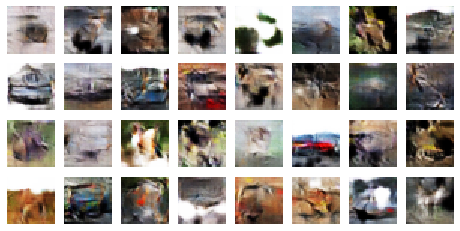

Epoch 48/100
Execution time: 56.84251928329468


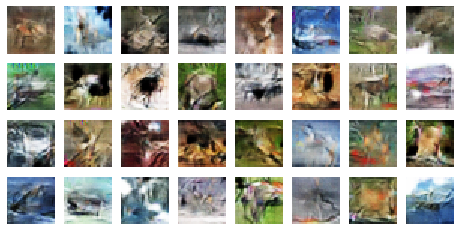

Epoch 49/100
Execution time: 56.621466398239136


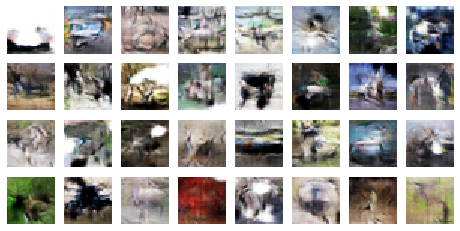

Epoch 50/100
Execution time: 64.07469177246094


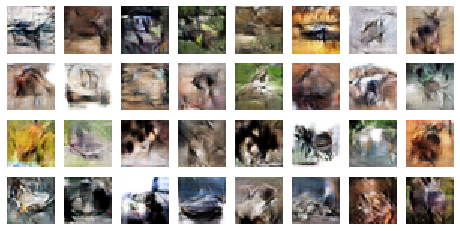

Epoch 51/100
Execution time: 56.62043595314026


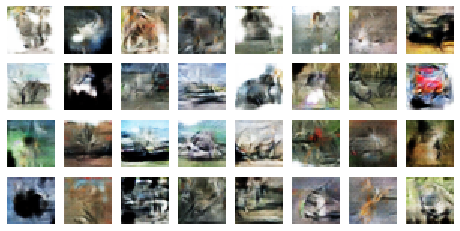

Epoch 52/100
Execution time: 56.68030047416687


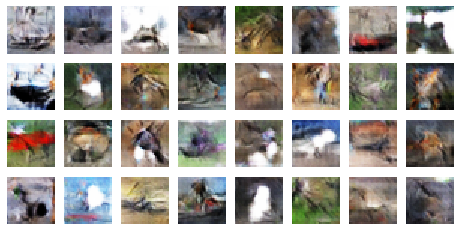

Epoch 53/100
Execution time: 57.28390026092529


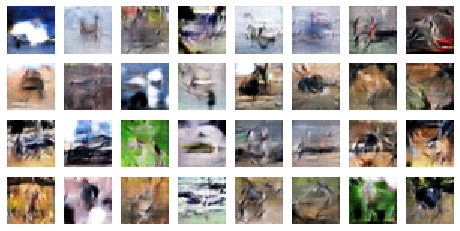

Epoch 54/100
Execution time: 56.83463501930237


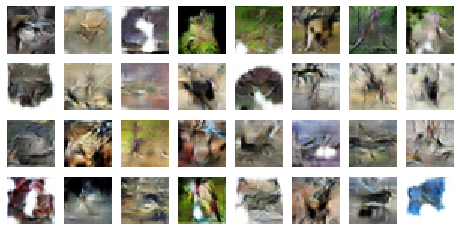

Epoch 55/100
Execution time: 56.53157353401184


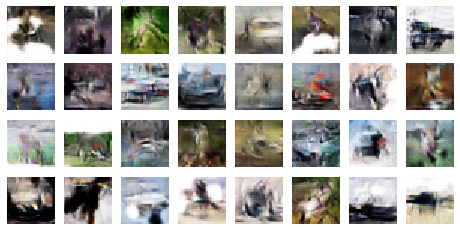

Epoch 56/100
Execution time: 56.949596881866455


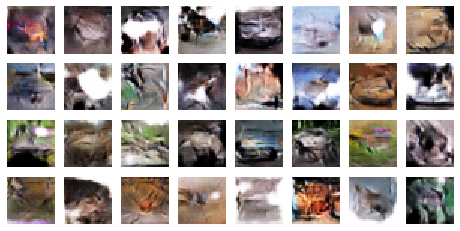

Epoch 57/100
Execution time: 56.841280698776245


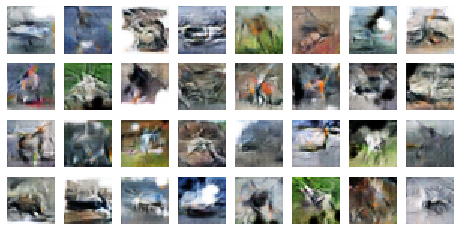

Epoch 58/100
Execution time: 56.79721784591675


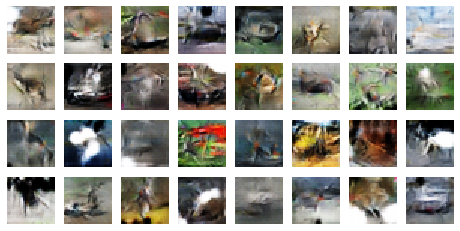

Epoch 59/100
Execution time: 56.65358543395996


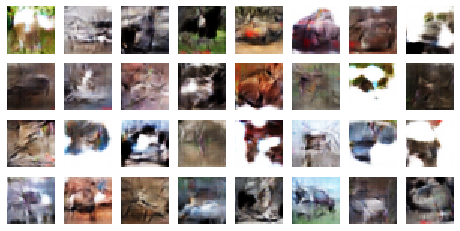

Epoch 60/100
Execution time: 63.973825454711914


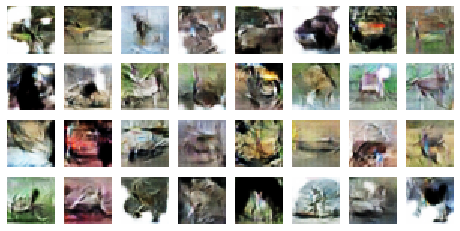

Epoch 61/100
Execution time: 57.094045877456665


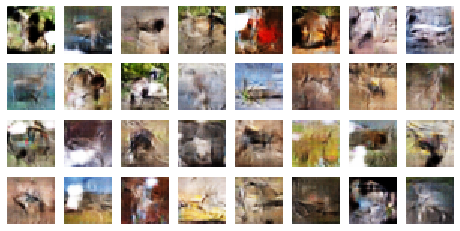

Epoch 62/100
Execution time: 56.50357532501221


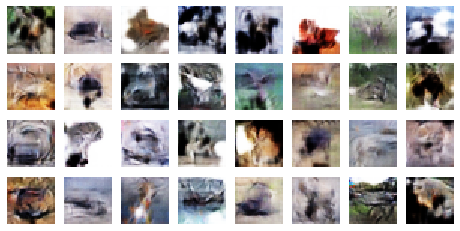

Epoch 63/100
Execution time: 57.017037868499756


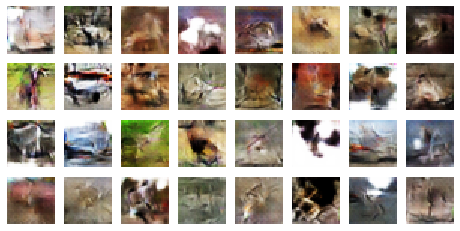

Epoch 64/100
Execution time: 56.830315351486206


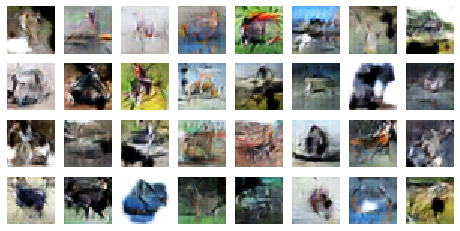

Epoch 65/100
Execution time: 56.60126996040344


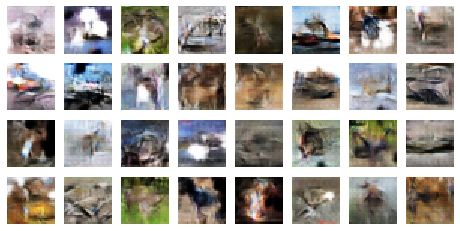

Epoch 66/100
Execution time: 57.020973443984985


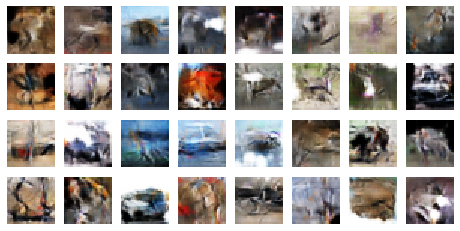

Epoch 67/100
Execution time: 56.96477198600769


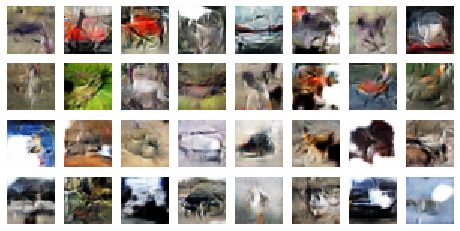

Epoch 68/100
Execution time: 57.04530310630798


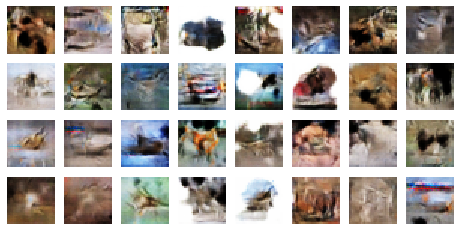

Epoch 69/100
Execution time: 56.920257568359375


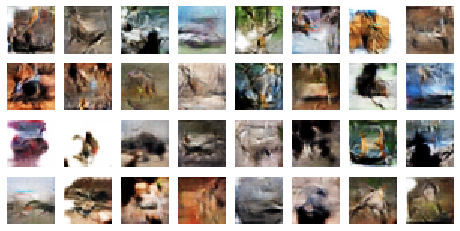

Epoch 70/100
Execution time: 63.455662965774536


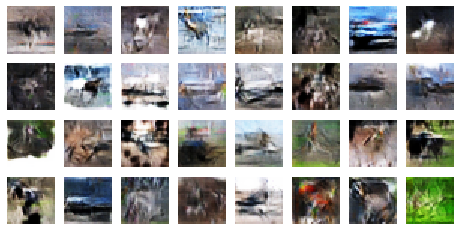

Epoch 71/100
Execution time: 57.12754464149475


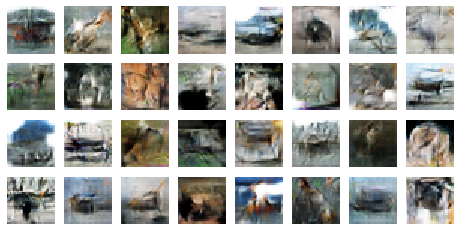

Epoch 72/100
Execution time: 56.86057233810425


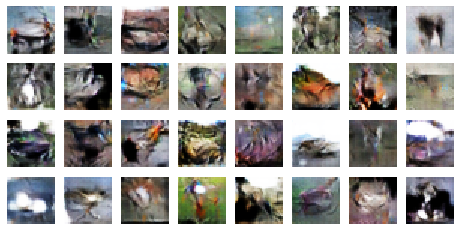

Epoch 73/100
Execution time: 56.801276206970215


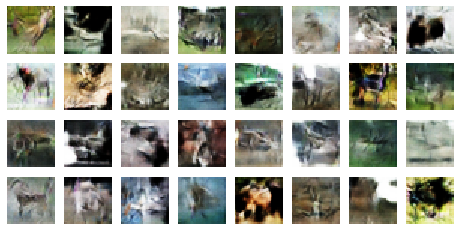

Epoch 74/100
Execution time: 56.91268801689148


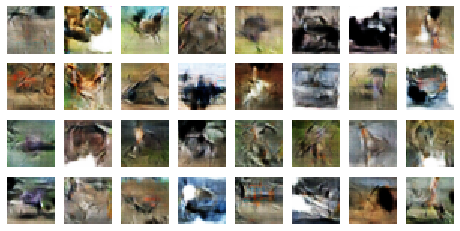

Epoch 75/100
Execution time: 56.73466897010803


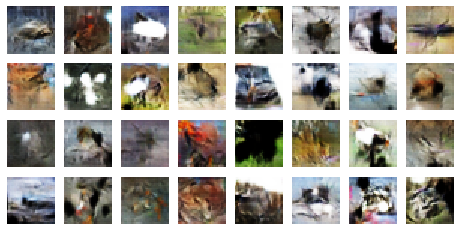

Epoch 76/100
Execution time: 57.288713455200195


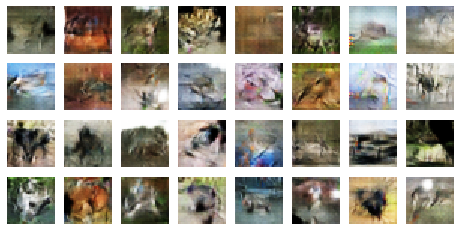

Epoch 77/100
Execution time: 57.11138081550598


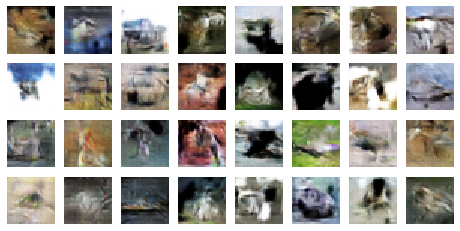

Epoch 78/100
Execution time: 57.03059959411621


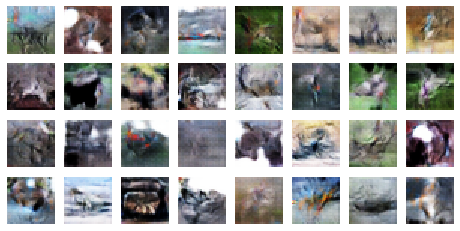

Epoch 79/100
Execution time: 57.01711821556091


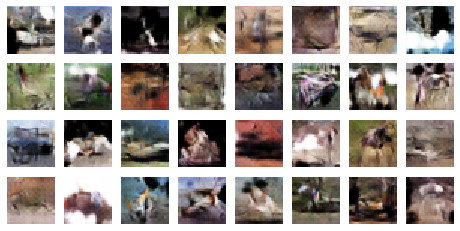

Epoch 80/100
Execution time: 63.92085886001587


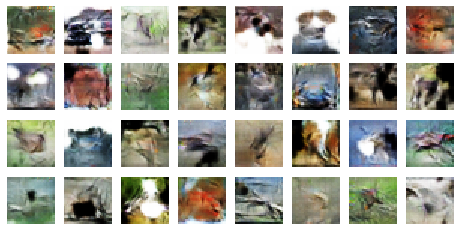

Epoch 81/100
Execution time: 57.11570119857788


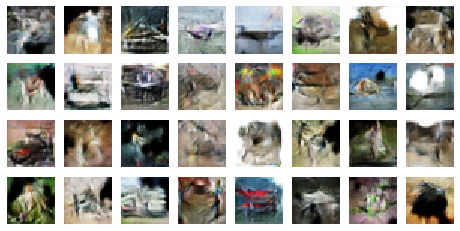

Epoch 82/100
Execution time: 57.19799852371216


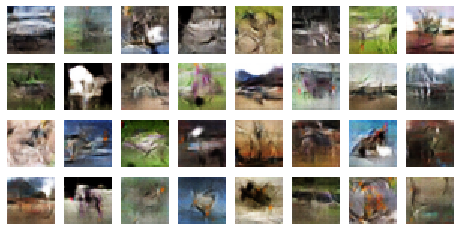

Epoch 83/100
Execution time: 57.25634837150574


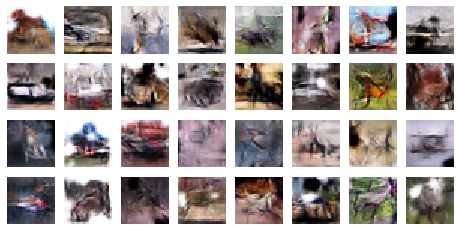

Epoch 84/100
Execution time: 56.98311805725098


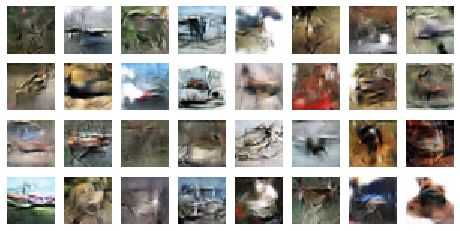

Epoch 85/100
Execution time: 57.007753133773804


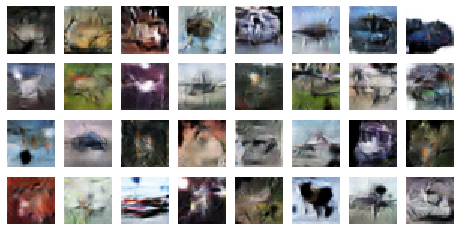

Epoch 86/100
Execution time: 57.156394720077515


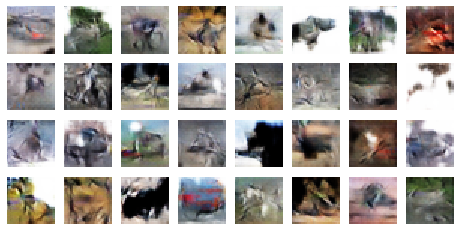

Epoch 87/100
Execution time: 57.038047313690186


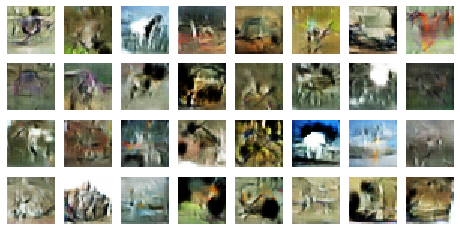

Epoch 88/100
Execution time: 57.11790609359741


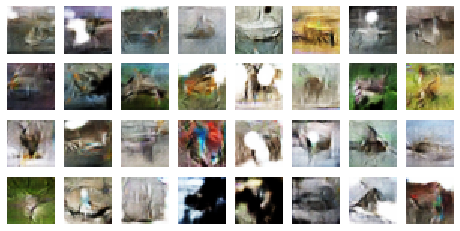

Epoch 89/100
Execution time: 56.8967399597168


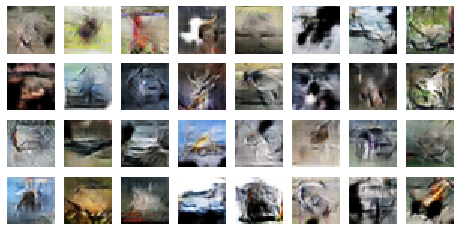

Epoch 90/100
Execution time: 64.17938232421875


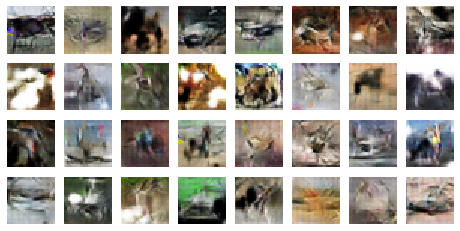

Epoch 91/100
Execution time: 57.193896770477295


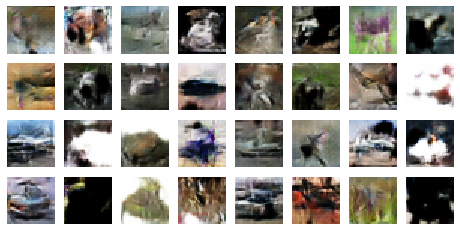

Epoch 92/100
Execution time: 56.98753595352173


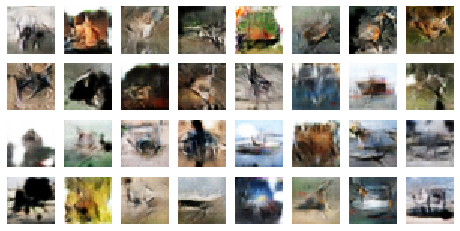

Epoch 93/100
Execution time: 57.15727639198303


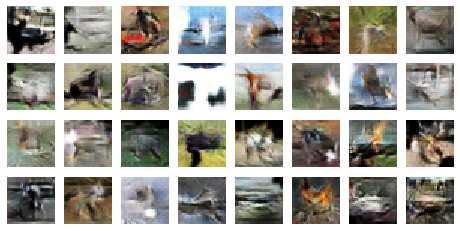

Epoch 94/100
Execution time: 56.967076539993286


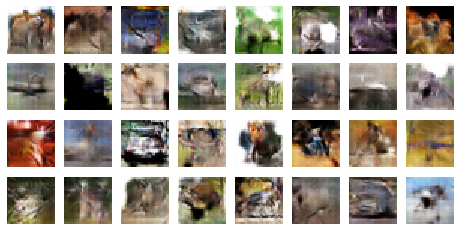

Epoch 95/100
Execution time: 56.9351224899292


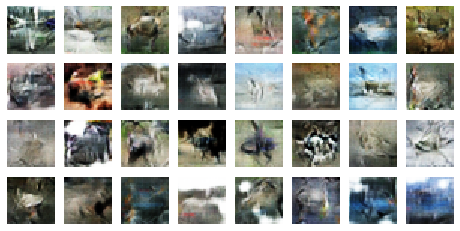

Epoch 96/100
Execution time: 57.38077998161316


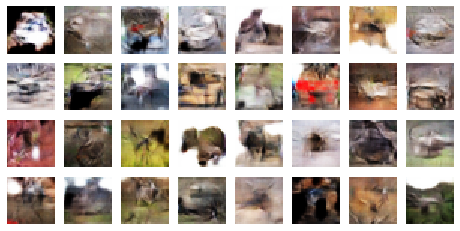

Epoch 97/100
Execution time: 57.052873849868774


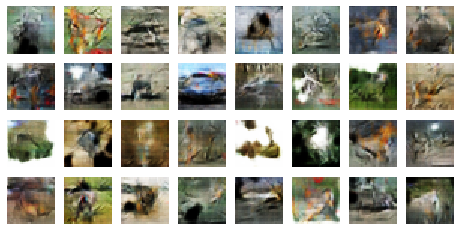

Epoch 98/100
Execution time: 57.272599935531616


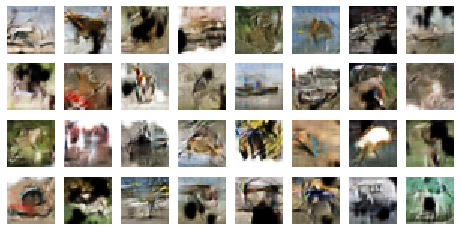

Epoch 99/100
Execution time: 57.064351320266724


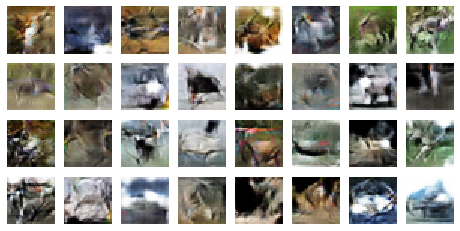

Epoch 100/100
Execution time: 64.0865478515625


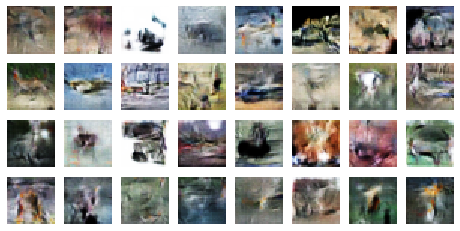

In [18]:
# Train the GAN model
history = train_gan(gan, dataset, batch_size, codings_size, n_epochs=100)

And we plot the mean accuracies obtained every 10 epochs:

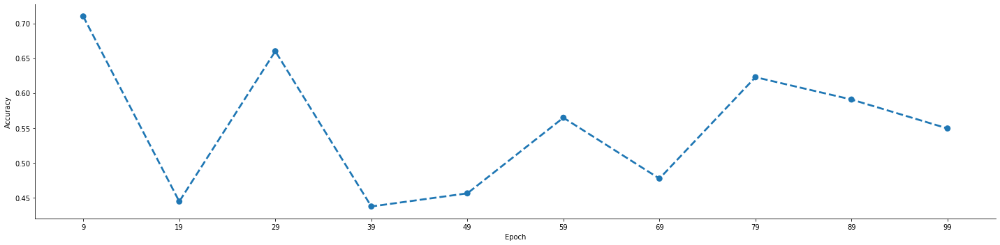

In [19]:
# Plot the validating accuracy with epochs
g = sns.catplot(x='Epoch', y='Accuracy', kind='point', aspect=4, markers="o", linestyles= "--", data=history)

The discriminator accuracy is unstable during the training. Improving the model will provide better results.